# MTG -  Basic Lands Classifier
## EDA & Data Preparation

In this notebook, we explore the dataset to gain some insights about the metadata and the images of the basic lands. In addition, our goal is to identify outlier images that should be removed from the training and validation sets.

In [1]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import os
import pandas as pd
import seaborn as sns
from shutil import copy
from tqdm import tqdm

pd.set_option('display.max_rows', 150)

In [2]:
# Read the dataset
basics = pd.read_csv('data/basic_lands_artworks.csv')

In [3]:
# Basic info
basics.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1246 entries, 0 to 1245
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   id                1246 non-null   object
 1   name              1246 non-null   object
 2   released_at       1246 non-null   object
 3   image_uris        1246 non-null   object
 4   set_name          1246 non-null   object
 5   collector_number  1246 non-null   object
 6   artist            1246 non-null   object
 7   art_crop_uri      1246 non-null   object
dtypes: object(8)
memory usage: 78.0+ KB


In [4]:
# Random sample of the dataset
basics.sample(5)

,id,name,released_at,image_uris,set_name,collector_number,artist,art_crop_uri
66,d7fcc1eb-8689-4b0f-9e56-cfeb4c8c1edb,Island,1997-05-01,{'small': 'https://c1.scryfall.com/file/scryfa...,Portal,201,Eric Peterson,https://c1.scryfall.com/file/scryfall-cards/ar...
114,93dc440e-53f8-45d7-bc3b-c9b9a67767de,Forest,1998-09-01,{'small': 'https://c1.scryfall.com/file/scryfa...,Asia Pacific Land Program,11,"Edward P. Beard, Jr.",https://c1.scryfall.com/file/scryfall-cards/ar...
296,b082f22f-6c01-4e8c-80ad-6fdae5c3f22f,Mountain,2003-10-02,{'small': 'https://c1.scryfall.com/file/scryfa...,Mirrodin,299,Mark Tedin,https://c1.scryfall.com/file/scryfall-cards/ar...
260,7bf7d68a-dbd0-45f3-acbb-59ee38e6057e,Plains,2002-10-07,{'small': 'https://c1.scryfall.com/file/scryfa...,Onslaught,331,Rob Alexander,https://c1.scryfall.com/file/scryfall-cards/ar...
1221,31915934-1e12-49ad-a745-30e1106b4eff,Island,2021-11-29,{'small': 'https://c1.scryfall.com/file/scryfa...,Secret Lair Drop,485,Riot Games,https://c1.scryfall.com/file/scryfall-cards/ar...


### Exploratory Data Analysis

In [5]:
# Check that there are no duplicates
basics['id'].nunique() == len(basics)

True

#### Class distribution

In [6]:
# Class distribution
basics['name'].value_counts(normalize=True).sort_index()

Forest      0.201445
Island      0.199839
Mountain    0.200642
Plains      0.199839
Swamp       0.198234
Name: name, dtype: float64

As expected, we can see that this is a balanced dataset: there are five class labels, each representing around 20% of the samples.

#### Sets

In [7]:
# Number of different sets
basics['set_name'].nunique()

147

In [8]:
# Number of images per set
imgs_per_set = basics.groupby('set_name')['name'].count().sort_values(ascending=False)
imgs_per_set

set_name
Jumpstart                                     40
Secret Lair Drop                              33
Portal                                        30
Adventures in the Forgotten Realms            20
Throne of Eldraine                            20
Odyssey                                       20
Ravnica: City of Guilds                       20
Shadowmoor                                    20
Khans of Tarkir                               20
Ixalan                                        20
Dominaria                                     20
Amonkhet                                      20
Battle for Zendikar                           20
Zendikar                                      19
Scars of Mirrodin                             19
Mercadian Masques                             19
Lorwyn                                        19
Time Spiral                                   19
Rise of the Eldrazi                           18
Mirrodin                                      18
Onslaught  

In [9]:
# Summary statistics of the number of images per set
imgs_per_set.describe()

count    147.000000
mean       8.476190
std        7.271951
min        1.000000
25%        3.000000
50%        5.000000
75%       15.000000
max       40.000000
Name: name, dtype: float64

There are 147 different sets, which have in average about 8 images each. We appreciate that there is a large dispersion in the number of images per set: values go from 1 to 40 and the coefficient of variation is 0.8579. Likely, there are quite a few missing images in some of the sets. However, given the fact the median is 5, it's probable that half or more of them have at least one image per basic land type. We can check this fact by assessing the number of unique land names per set:

In [10]:
# Summary statistics of the number of unique land names per set
lands_per_set = basics.groupby('set_name')['name'].nunique()
lands_per_set.describe()

count    147.000000
mean       3.802721
std        1.590380
min        1.000000
25%        2.000000
50%        5.000000
75%        5.000000
max        5.000000
Name: name, dtype: float64

#### Year of release

In [11]:
# Extract the year of release
basics['released_year'] = basics['released_at'].map(lambda x: x[:4]).astype(int)

# Sample some results
basics[['released_at', 'released_year']].sample(5)

,released_at,released_year
170,1999-10-04,1999
318,2004-10-01,2004
666,2013-09-27,2013
353,2006-01-01,2006
354,2006-01-01,2006


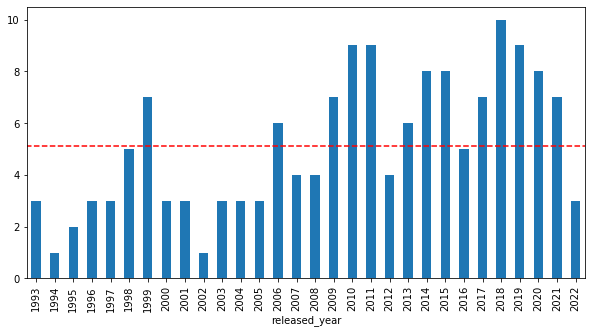

In [12]:
# Plot the number of sets released each year
plt.figure(figsize=(10,5))
basics.groupby('released_year')['set_name'].nunique().sort_index().plot(kind='bar')
# The red dashed line represents the historical average of annual releases
plt.hlines(y=basics.groupby('released_year')['set_name'].nunique().mean(),
           colors='red', linestyles='dashed',
           xmin=-1, xmax=len(basics.groupby('released_year')));

In [13]:
# Oldest sets
basics.loc[basics['released_year'] <= 1995, 'set_name'].unique()

array(['Limited Edition Alpha', 'Collectors’ Edition',
       'Intl. Collectors’ Edition', 'Revised Edition', 'Fourth Edition',
       'Ice Age'], dtype=object)

In [14]:
# Most recent sets
basics.loc[basics['released_year'] >= 2020, 'set_name'].unique()

array(['MagicFest 2020', 'Theros Beyond Death', 'Unsanctioned',
       'Ikoria: Lair of Behemoths', 'Core Set 2021', 'Jumpstart',
       'Secret Lair Drop', 'Zendikar Rising', 'Kaldheim',
       'Strixhaven: School of Mages', 'Modern Horizons 2',
       'Adventures in the Forgotten Realms', 'Innistrad: Midnight Hunt',
       'Innistrad: Crimson Vow', 'Kamigawa: Neon Dynasty', 'Unfinity'],
      dtype=object)

In [15]:
# Summary statistics of the number of sets released each year
basics.groupby('released_year')['set_name'].nunique().describe()

count    30.000000
mean      5.133333
std       2.609444
min       1.000000
25%       3.000000
50%       4.500000
75%       7.000000
max      10.000000
Name: set_name, dtype: float64

Magic: The Gathering has been around since 1993, and every year at least one new set has come out. In it's 30-year history, the last five have been particularly prolific in terms of releases: each of them had more new sets than the average of 5, with a peak of 10 releases in 2018. 2022 has just begun as of this writing, January 2022, so could be left out of the summary statistics:

In [16]:
# Summary statistics of the number of sets released each year until 2020
basics.loc[basics['released_year'] < 2022].groupby('released_year')['set_name'].nunique().describe()

count    29.000000
mean      5.206897
std       2.623783
min       1.000000
25%       3.000000
50%       5.000000
75%       7.000000
max      10.000000
Name: set_name, dtype: float64

During January 2022, Wizards of the Coast has released the same number of sets in just one month as each year for most of the early 2000s, so excluding the current year from the analysis has little impact on the summary statistics other than slightly increasing the mean, median and standard deviation.

#### Artists

In [17]:
# Number of different artists
basics['artist'].nunique()

191

In [18]:
# Top 30 of the most frequent artists
basics['artist'].value_counts().sort_values(ascending=False).head(30)

John Avon                103
Adam Paquette             83
Rob Alexander             61
Titus Lunter              53
Sam Burley                43
Jonas De Ro               40
Jung Park                 31
James Paick               26
Richard Wright            26
Alayna Danner             24
Mark Poole                22
Noah Bradley              21
Christine Choi            18
Douglas Shuler            18
Mark Tedin                17
Terese Nielsen            16
Yeong-Hao Han             16
Piotr Dura                15
Andreas Rocha             15
Florian de Gesincourt     14
Lars Grant-West           13
Martina Pilcerova         12
Dimitar Marinski          12
Donato Giancola           12
Scott Bailey              11
Raoul Vitale              10
Kev Walker                10
Anthony S. Waters         10
Tomasz Jedruszek          10
Eytan Zana                10
Name: artist, dtype: int64

Most of these names should be familiar to any experienced Magic player. Just to highlight a few of my favorites: Terese Nielsen, Mark Poole, Rob Alexander, Adam Paquette and, of course, good old John Avon.

In [19]:
# Summary statistics of the number of different artists in sets with images of every basic land type
basics.loc[basics['set_name'].isin(lands_per_set.loc[lands_per_set >= 5].index)] \
      .groupby('set_name')['artist'].nunique().describe()

count    86.000000
mean      5.232558
std       3.803016
min       1.000000
25%       3.000000
50%       5.000000
75%       6.750000
max      19.000000
Name: artist, dtype: float64

While some sets were fully illustrated by just one person, most of them have at least one different artist per basic land type. At the other extreme, there's a set which features 19 different artists. That's quite a lot!

#### Artworks

In [20]:
# Function to plot a grid of basic land artworks from a particular set
def plot_set(df=basics, data_dir='data/imgs', set_name=None):
    """Plots a grid of basic land artworks from a particular set.
    
    Parameters
    ----------
    df : DataFrame, default `basics`
        DataFrame that contains metadata about the basic land artworks.
    data_dir : str, default 'data/imgs'
        Path of the directory where the jpg files of the artworks are located.
    set_name : str, default `None`
        Set name. By default, a random set name will be chosen.
    """
    # If not given, take a random 'set_name'
    if set_name == None:
        set_name = np.random.choice(df['set_name'].unique())
    
    # Filter by 'set_name'
    set_ = df.loc[df['set_name'] == set_name]
    released_year = df.loc[df['set_name'] == set_name, 'released_year'].min()
    
    # Color pie order
    color_pie_order = {
        'Plains': 0,
        'Island': 1,
        'Swamp': 2,
        'Mountain': 3,
        'Forest': 4
    }
    
    # Basic land types in the set
    names = sorted(set_['name'].unique(),
                   key=lambda x: color_pie_order[x])
    
    # Grid dimensions
    # One column per distinct basic land type present in the set
    ncols = set_['name'].nunique()
    # Number of rows equal to the maximum quantity of distinct images among basic land types
    nrows = set_.groupby('name')['name'].count().max()

    # Define the subplots
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols*6, nrows*5), constrained_layout=True)

    # Iterate over columns
    for j, name in enumerate(names):

        # Get the ids of the artworks and some metadata
        ids = set_.loc[set_['name'] == name,
                       ['id', 'name', 'artist', 'collector_number', 'released_at']] \
                  .sort_values(['released_at', 'collector_number'])
        
        # There are four different possible grid dimensions, each of which is formatted separately
        # More than one row and more than one column
        if nrows > 1 and ncols > 1:
            # Iterate over rows
            for i in range(min(nrows, len(ids))):
                # Plot the artwork
                axes[i,j].imshow(plt.imread(os.path.join(data_dir, ids.iloc[i]['id']+'.jpg')))
                # Title
                title = "{} #{}\nArtist: {}\n".format(
                    ids.iloc[i]['name'], ids.iloc[i]['collector_number'], ids.iloc[i]['artist']
                )
                axes[i,j].set_title(title, size=15)
                axes[i, j].set_axis_off() # Suppress axis
                # Suppress axis of empty subplots, if any
                if nrows != len(ids):
                    for _ in range(len(ids), nrows):
                        axes[_,j].set_axis_off()
        
        # Only one row and more than one column
        elif nrows == 1 and ncols > 1:
            # Plot the artwork
            axes[j].imshow(plt.imread(os.path.join(data_dir, ids.iloc[0]['id']+'.jpg')))
            # Title
            title = "{} #{}\nArtist: {}\n".format(
                ids.iloc[0]['name'], ids.iloc[0]['collector_number'], ids.iloc[0]['artist']
            )
            axes[j].set_title(title, size=15)
            axes[j].set_axis_off() # Suppress axis
        
        # More than one row and only one column
        elif nrows > 1 and ncols == 1:
            # Iterate over rows
            for i in range(min(nrows, len(ids))):
                # Plot the artwork
                axes[i].imshow(plt.imread(os.path.join(data_dir, ids.iloc[i]['id']+'.jpg')))
                # Title
                title = "{} #{}\nArtist: {}\n".format(
                    ids.iloc[i]['name'], ids.iloc[i]['collector_number'], ids.iloc[i]['artist']
                )
                axes[i].set_title(title, size=15)
                axes[i].set_axis_off() # Suppress axis
        
        # Just one image
        elif nrows == 1 and ncols == 1:
            # Plot the artwork
            axes.imshow(plt.imread(os.path.join(data_dir, ids.iloc[0]['id']+'.jpg')))
            # Title
            title = "{} #{}\nArtist: {}\n".format(
                ids.iloc[0]['name'], ids.iloc[0]['collector_number'], ids.iloc[0]['artist']
            )
            axes.set_title(title, size=15)
            axes.set_axis_off() # Suppress axis
    
    # Suptitle
    fig.suptitle('Basic lands - {} ({})'.format(set_name, released_year), size=30, y=1.1)
    plt.show();

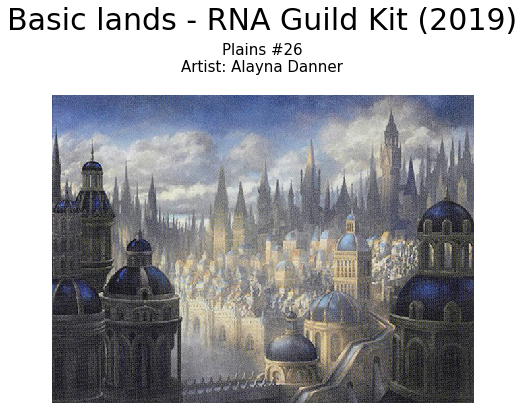

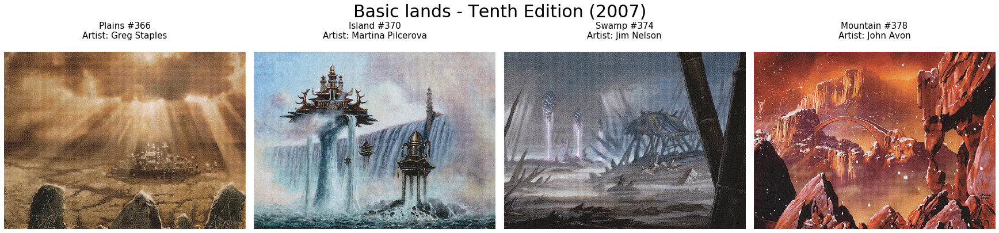

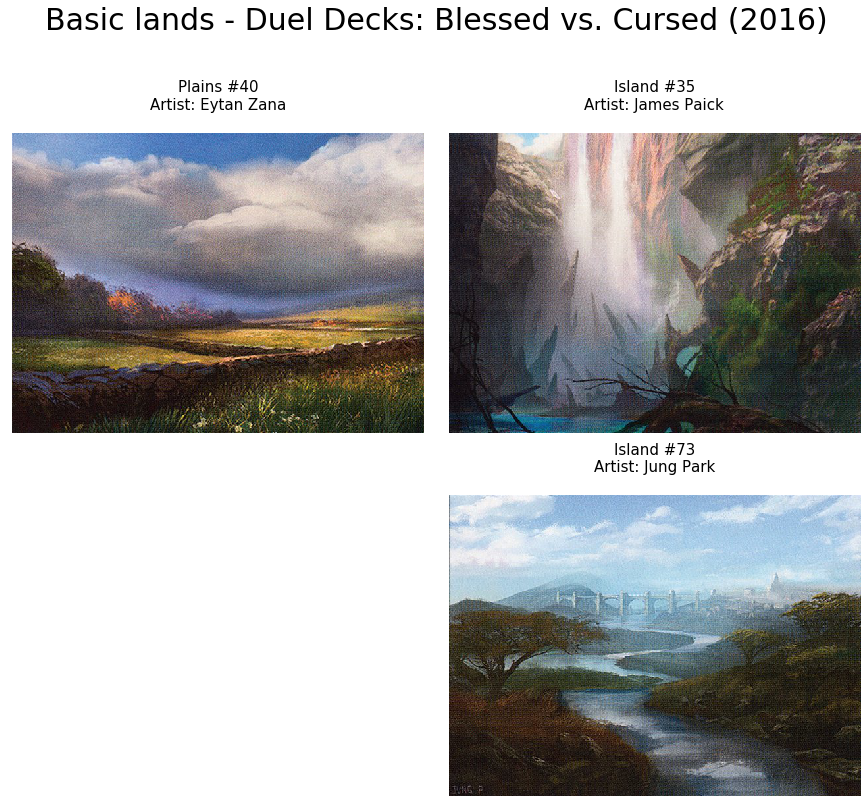

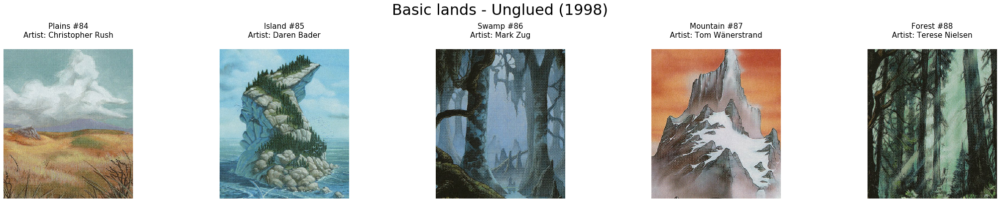

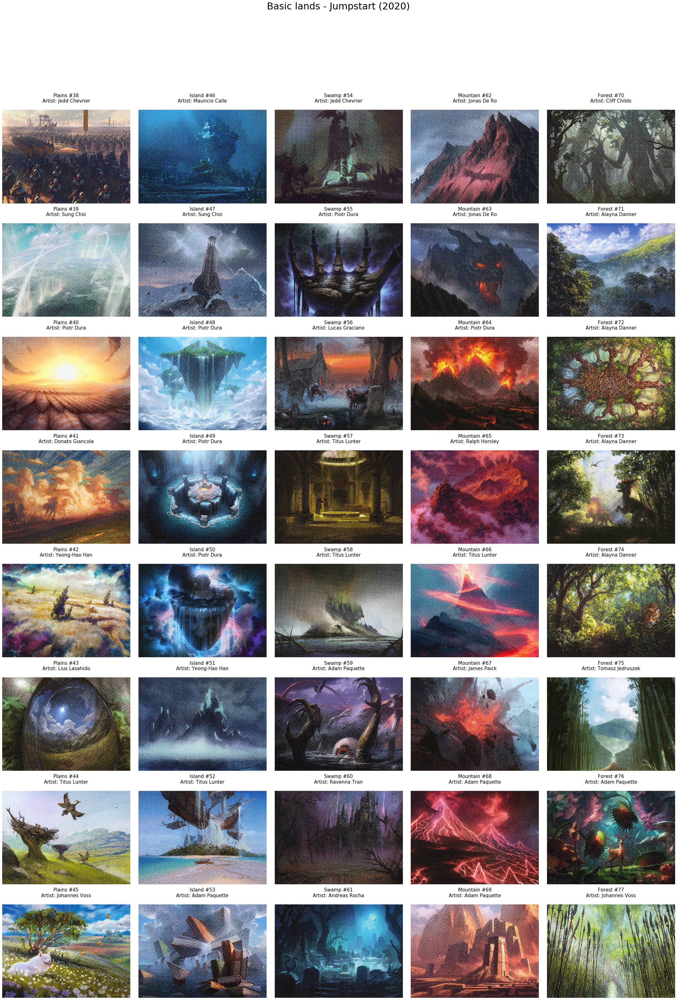

In [21]:
# Explore some random sets
for i in range(5):
    plot_set()

Beautiful pieces of art! After visualizing a couple of sets, we take note of these things:
- As anticipated, some sets have missing images. Exploring some cases in more detail, we found out that some of them are available on the Scryfall website ([Scar of Mirrodin's Plains # 231](https://c1.scryfall.com/file/scryfall-cards/art_crop/front/4/4/440680d3-1eea-442a-b58e-96db09bc279e.jpg?1562816918), for example). This could mean that bulk data isn't complete and that we could gather more samples scraping the website.
- Also, we notice that there are no duplicated artworks in the dataset. For example, [Mirage's Mountain #346](https://scryfall.com/card/mir/346/mountain) was reprinted as [Classic Sixth Edition's Mountain #343](https://scryfall.com/card/6ed/343/mountain), what we only find the first version among the images.
- There are a few sets which present atypical artworks, in particular, Kamigawa: Neon Dynasty, Innistrad: Midnight Hunt and Innistrad: Crimson Vow (black and white images), and those artworks by Mark Riddick and Jeanne D'Angelo in recents Secret Lair Drop editions. We are going to drop these images from the training and validation datasets.

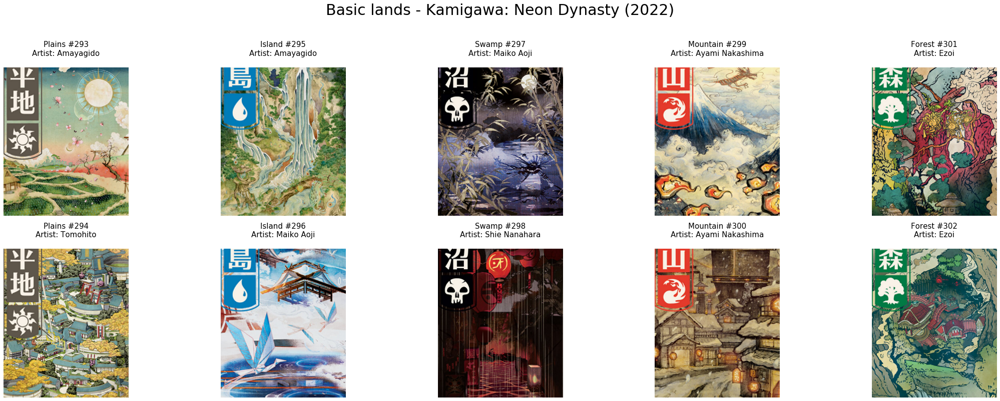

In [22]:
# Kamigawa: Neon Dynasty
plot_set(set_name='Kamigawa: Neon Dynasty')

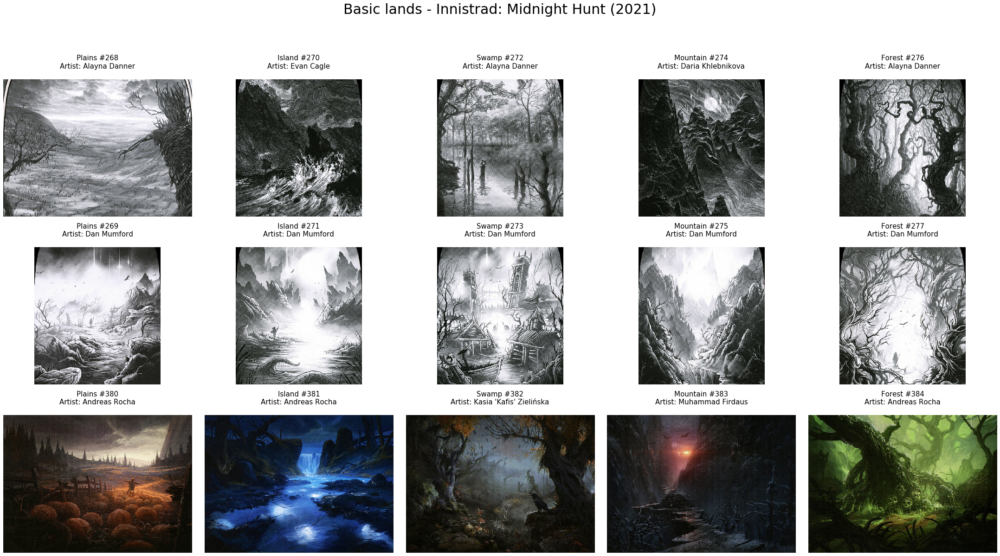

In [23]:
# Innistrad: Midnight Hunt
plot_set(set_name='Innistrad: Midnight Hunt')

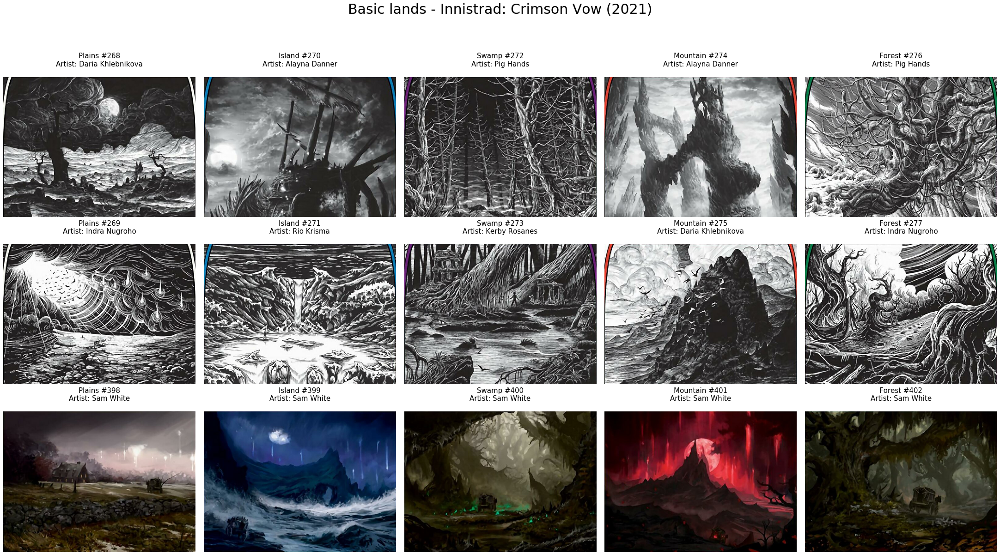

In [24]:
# Innistrad: Crimson Vow
plot_set(set_name='Innistrad: Crimson Vow')

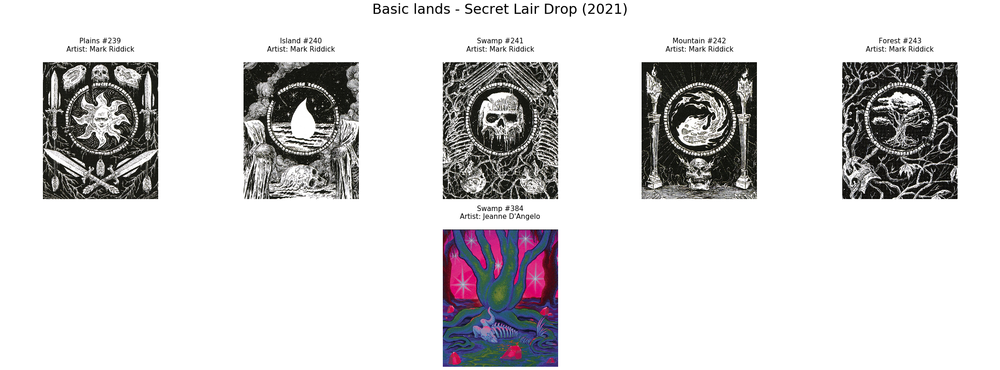

In [25]:
# Secret Lair Drop - Mark Riddick and Jeanne D'Angelo
plot_set(df=basics.loc[(basics['artist'].isin(['Mark Riddick', "Jeanne D'Angelo"]))])

#### Image size and channel analysis

We'll get the height and width of each image and we'll compute the mean pixel value of each channel.

In [26]:
# Functions to get the height, width and mean of the pixel values of each channel of an image
def get_height_width(img_array):
    """Returns the height and width of an image array.
    
    Parameters
    ----------
    img_array : ndarray
        Image data with shape (height, width, channels).
    
    Returns
    -------
    height_width : tuple
        Tuple containing the height and width of the image.
    """
    height_width = img_array.shape[0], img_array.shape[1]
    
    return height_width


def compute_channel_means(img_array):
    """Computes the mean of the pixel values of the red, green and blue channels of an image array.
    
    Parameters
    ----------
    img_array : ndarray
        Image data with shape (height, width, channels).
    
    Returns
    -------
    channel_means : array
        Array containing the average of the pixel values of the red, green and blue channels.
    """
    channel_means = np.round(np.mean(img_array, axis=(0,1)), 4)
    
    return channel_means


def get_img_feats(fname, data_dir='data/imgs'):
    """Returns the height, width and mean of the pixel values of each channel of an image.
    
    Parameters
    ----------
    fname : str
        Filename of the image.
    data_dir : str, default 'data/imgs'
        Path of the directory where the image is located.
        
    Returns
    -------
    feats : tuple
        Tuple containing the image features.
    """
    # Read the image into an array
    fname_path = os.path.join(data_dir, fname)
    img_array = plt.imread(fname_path)
    
    # Get height and width
    height, width = get_height_width(img_array)
    
    # Compute the mean of the pixel values of each channel of the image
    red_mean, green_mean, blue_mean = compute_channel_means(img_array)
    
    return height, width, red_mean, green_mean, blue_mean

In [27]:
# Obtain the height, width and mean of the pixel values of each channel of the artworks
basics['img_feats'] = (basics['id']+'.jpg').map(get_img_feats)
basics['img_height'] = basics['img_feats'].map(lambda x: x[0])
basics['img_width'] = basics['img_feats'].map(lambda x: x[1])
basics['img_red_mean'] = basics['img_feats'].map(lambda x: x[2])
basics['img_green_mean'] = basics['img_feats'].map(lambda x: x[3])
basics['img_blue_mean'] = basics['img_feats'].map(lambda x: x[4])

In [28]:
# Sample some results
basics[['id', 'name', 'img_feats', 'img_height', 'img_width', 'img_red_mean', 'img_green_mean', 'img_blue_mean']].sample(10)

,id,name,img_feats,img_height,img_width,img_red_mean,img_green_mean,img_blue_mean
732,966ac118-6d94-4f3b-9873-7a2440ab92d9,Island,"(457, 626, 89.1386, 91.008, 98.5408)",457,626,89.1386,91.0080,98.5408
780,314b835b-b03e-43fe-b924-67139e2f266a,Forest,"(457, 626, 76.3168, 81.4888, 49.7975)",457,626,76.3168,81.4888,49.7975
229,fe14fc96-f33a-4bd2-8b04-c339936d3c24,Mountain,"(460, 571, 109.0567, 103.6944, 106.1988)",460,571,109.0567,103.6944,106.1988
741,67becef5-cd70-4fe9-b8a3-1bff2ea04ab4,Forest,"(457, 626, 67.6147, 62.6671, 56.3506)",457,626,67.6147,62.6671,56.3506
306,901c4c2e-0403-483c-9505-63ca51156a29,Swamp,"(452, 616, 88.4958, 84.1749, 74.1584)",452,616,88.4958,84.1749,74.1584
1002,7ded4b2a-ba56-43da-8ea7-392b77fc2926,Plains,"(457, 626, 172.3698, 150.8745, 106.5186)",457,626,172.3698,150.8745,106.5186
852,9865657b-43da-48e2-ac55-6a29c21df253,Mountain,"(457, 626, 79.5028, 51.996, 39.4562)",457,626,79.5028,51.9960,39.4562
178,628bfeff-66f6-480c-b705-c08241278005,Forest,"(460, 571, 50.5841, 65.1408, 81.4237)",460,571,50.5841,65.1408,81.4237
682,ac2c51de-2ec9-4a38-a117-75e90abf0feb,Forest,"(704, 566, 100.7382, 120.1785, 118.4463)",704,566,100.7382,120.1785,118.4463
822,e4508384-7c5b-4189-80e6-1fc8a0fd4692,Forest,"(457, 626, 112.0503, 99.9479, 63.0676)",457,626,112.0503,99.9479,63.0676


In [29]:
# Summary statistics of these features
basics[['img_height', 'img_width', 'img_red_mean', 'img_green_mean', 'img_blue_mean']].describe()

,img_height,img_width,img_red_mean,img_green_mean,img_blue_mean
count,1246.000000,1246.000000,1246.000000,1246.000000,1246.000000
mean,481.173355,611.365971,106.143548,101.059188,91.116442
std,78.370578,27.635655,36.362960,32.194364,35.165115
min,451.000000,473.000000,13.768700,17.468900,17.826300
25%,452.000000,616.000000,79.958075,76.432600,64.412750
50%,457.000000,616.000000,103.646500,98.716300,85.646600
75%,460.000000,626.000000,130.960500,123.825225,114.102625
max,846.000000,745.000000,229.879400,210.984300,205.952300


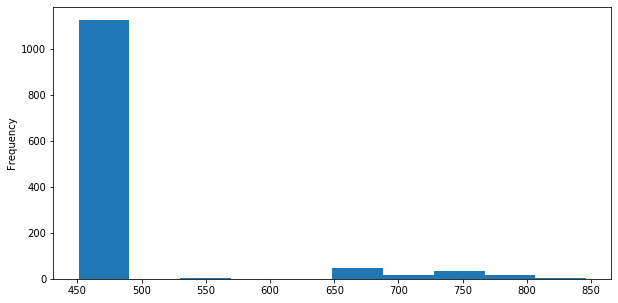

In [30]:
# Histogram of image heights
plt.figure(figsize=(10,5))
basics['img_height'].plot(kind='hist', bins=10);

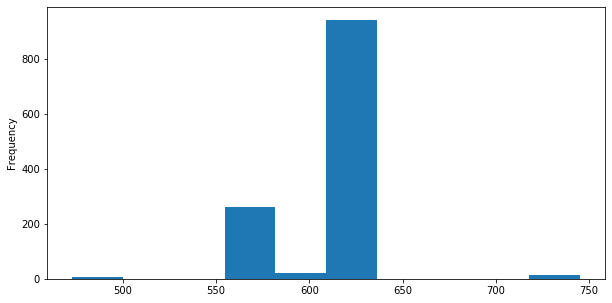

In [31]:
# Histogram of image widths
plt.figure(figsize=(10,5))
basics['img_width'].plot(kind='hist', bins=10);

Most images are between 450 and 460 pixels high and between 610 and 630 pixels wide, approximately.

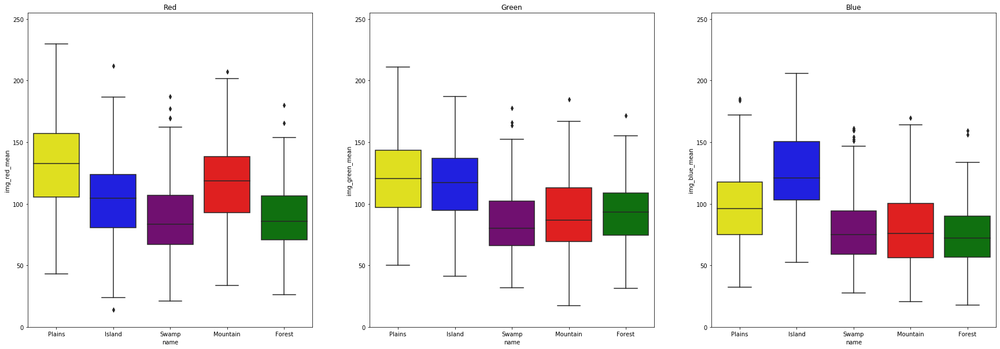

In [32]:
# Box plots of average pixel values of RGB channels per basic land type
fig, axes = plt.subplots(1, 3, figsize=(30, 10))
for i, channel in enumerate(['red', 'green', 'blue']):
    ax = sns.boxplot(data=basics, x='name', y=f'img_{channel}_mean', ax=axes[i],
                     palette=['yellow', 'blue', 'purple', 'red', 'green'])
    ax.set_title(channel.title())
    ax.set_ylim(0,255)

Some associations that might be expected to be obvious may not be so. While Islands have noticeably more intense pixel values in the blue channel than the rest of the lands, the same is not true for Forests and green, which appear to be outweighed by the intensity of Plains and Islands in that channel. On the other hand, although Mountains have high values in the red channel, Plains also have equal or higher values. 
The distributions of the mean values of the green and blue channels for Swamps, Mountains, and Forests are remarkably similar.

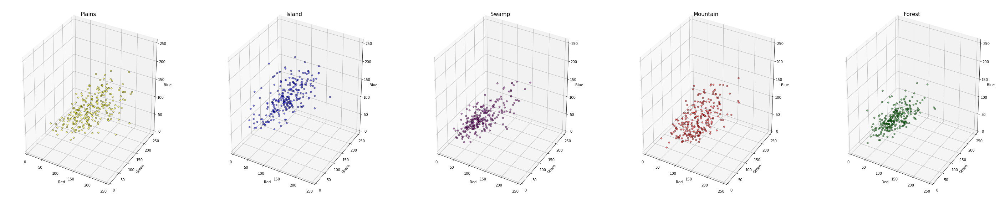

In [33]:
# 3d scatter plots of average pixel values of RGB channels per basic land type
colors = {
    'Plains':'yellow',
    'Island':'blue',
    'Swamp':'purple',
    'Mountain':'red',
    'Forest':'green'
}

fig = plt.figure(figsize=(50,10))
for i, (name, color)  in enumerate(colors.items()):
    ax = fig.add_subplot(1, 5, i+1, projection='3d')
    basic_land = basics.loc[basics['name']==name]
    ax.scatter(
        basic_land['img_red_mean'] ,
        basic_land['img_green_mean'],
        basic_land['img_blue_mean'],
        c=color, alpha=.5,
        marker='o', edgecolor='black')
    ax.set_xlim(0,255)
    ax.set_ylim(0,255)
    ax.set_zlim(0,255)
    ax.set_title(name, size=15)
    ax.set_xlabel('Red')
    ax.set_ylabel('Green')
    ax.set_zlabel('Blue')

We appreciate how Swamps and Forests tend to be grouped in a certain segment of space. Also, while Plains and Mountains seem to be quite spread out, Islands look like the most distinguishable cluster.

### Data preparation

We'll create the training set by taking a random sample of 80% of the images from each class, and the rest of the images will be used as the validation set. We are going to copy the images belonging to each data split and class to specific directories, so we can read them using TensorFlow's `ImageDataGenerator`.

In [34]:
# Images to be removed from the training and validation sets
to_remove = \
basics.loc[
    (basics['set_name'] == 'Kamigawa: Neon Dynasty') |
    (basics['artist'].isin(['Mark Riddick', "Jeanne D'Angelo"])) |
    ((~basics['artist'].isin(['Andreas Rocha', "Kasia 'Kafis' Zielińska", 'Muhammad Firdaus'])) & (basics['set_name'] == 'Innistrad: Midnight Hunt')) |
    ((basics['artist'] != 'Sam White') & (basics['set_name'] == 'Innistrad: Crimson Vow'))
]

to_remove.shape

(36, 15)

In [35]:
# Drop those images
basics.drop(to_remove.index, inplace=True)
basics.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1210 entries, 0 to 1245
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                1210 non-null   object 
 1   name              1210 non-null   object 
 2   released_at       1210 non-null   object 
 3   image_uris        1210 non-null   object 
 4   set_name          1210 non-null   object 
 5   collector_number  1210 non-null   object 
 6   artist            1210 non-null   object 
 7   art_crop_uri      1210 non-null   object 
 8   released_year     1210 non-null   int64  
 9   img_feats         1210 non-null   object 
 10  img_height        1210 non-null   int64  
 11  img_width         1210 non-null   int64  
 12  img_red_mean      1210 non-null   float64
 13  img_green_mean    1210 non-null   float64
 14  img_blue_mean     1210 non-null   float64
dtypes: float64(3), int64(3), object(9)
memory usage: 151.2+ KB


In [36]:
# Class distribution after drop continues to be balanced
basics['name'].value_counts(normalize=True)

Forest      0.201653
Mountain    0.200826
Island      0.200000
Plains      0.200000
Swamp       0.197521
Name: name, dtype: float64

In [37]:
# Make 'train' and 'val' directories for those data splits
root_dir = 'data'
data_dir = os.path.join(root_dir, 'imgs')
train_dir = 'train'
val_dir = 'val'

if not os.path.exists(os.path.join(root_dir, train_dir)):
    os.makedirs(os.path.join(root_dir, train_dir))

if not os.path.exists(os.path.join(root_dir, val_dir)):
    os.makedirs(os.path.join(root_dir, val_dir))

In [38]:
# Copy the images to the 'train' and 'val' directories,
# creating a specific subdirectory for each label
for name in basics['name'].unique():
    # Filter by 'name'
    ids = basics.loc[basics['name'] == name, ['id', 'name']]
    
    # Shuffle the dataset
    ids = ids.sample(frac=1., random_state=42)
    
    # Number of samples
    n_samples = len(ids)
    
    # 80% of the samples as the training set
    train_samples = int(n_samples * 0.8)
    
    # 'train' subdirectory
    train_dst = os.path.join(os.path.join(root_dir, train_dir), name)
    if not os.path.exists(train_dst):
        os.makedirs(train_dst)
    
    # Copy the images of the training set
    for idx in ids[:train_samples]['id']:
        src = os.path.join(data_dir, idx + '.jpg')
        dst = os.path.join(train_dst)
        copy(src, dst)
    
    # 'val' subdirectory
    val_dst = os.path.join(os.path.join(root_dir, val_dir), name)
    if not os.path.exists(val_dst):
        os.makedirs(val_dst)

    # Copy the images of the validation set
    for idx in ids[train_samples:]['id']:
        src = os.path.join(data_dir, idx + '.jpg')
        dst = os.path.join(val_dst)
        copy(src, dst)

In [39]:
# Number of training samples
train_samples = sum(len(files) for _, _, files in os.walk(os.path.join(root_dir, train_dir)))
train_samples

966

In [40]:
# Number of validation samples
val_samples = sum(len(files) for _, _, files in os.walk(os.path.join(root_dir, val_dir)))
val_samples

244

In [41]:
# Check whether we've successfully copied every image in the dataset
train_samples + val_samples == len(basics)

True